# Explore data augmentations

This notebook will be used to test different data augmentation strategies. In your config file, you can modify the augmentations by adding `data_augmentation_options`. For example, I would like to add a random RGB to gray transform with a probability of 0.2:
```
data_augmentation_options {
    random_rgb_to_gray {
    probability: 0.2
    }
```

A complete list of augmentation is provided the [`preprocessor.proto` file of the Tf Object Detection API](https://github.com/tensorflow/models/blob/master/research/object_detection/protos/preprocessor.proto).

### Helper functions

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from utils import get_train_input

In [22]:
def recenter_image(image):
    # ssd preprocessing
    image += [123.68, 116.779, 103.939]
    return image

#add ax variable for plot image as 2row 5column
def display_instances(image, bboxes, classes, ax):
    image = recenter_image(image)
    w, h, _ = image.shape
    # resize the bboxes
    bboxes[:, [0, 2]] *= w
    bboxes[:, [1, 3]] *= h
    
    ax.imshow(image.astype(np.uint8))
    for bb, cl in zip(bboxes, classes):
        y1, x1, y2, x2 = bb
        rec = Rectangle((x1, y1), x2-x1, y2-y1, facecolor='none', edgecolor='r', linewidth=2)
        ax.add_patch(rec)
    ax.axis('off')


def display_batch(batch):
    # get images, bboxes and classes
    batched_images = batch[0]['image'].numpy()
    batched_bboxes = batch[1]['groundtruth_boxes'].numpy()
    batched_classes = batch[1]['groundtruth_classes'].numpy()
    num_bboxes = batch[1]['num_groundtruth_boxes'].numpy()
    batch_size = batched_images.shape[0]
    
    # prepare image plot
    
    #plt.subplots(,) -->control image row and column
    fig, axes = plt.subplots(1, 2, figsize=(40, 30))
    axes = axes.flatten()
    
    for idx in range(batch_size):
        display_instances(batched_images[idx, ...], 
                          batched_bboxes[idx, :num_bboxes[idx], :],
                          batched_classes[idx, ...],
                          axes[idx])
    
    # 남는 플롯에 대해 축을 비활성화합니다.
    for idx in range(batch_size, len(axes)):
        axes[idx].axis('off')

    plt.tight_layout()
    plt.show()

### Display augmentations

In [24]:
from utils import get_train_input

In [26]:
train_dataset = get_train_input("./experiments/reference/pipeline_new.config")

INFO:tensorflow:Reading unweighted datasets: ['/home/workspace/data/train/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10226164909075980558_180_000_200_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-11076364019363412893_1711_000_1731_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10094743350625019937_3420_000_3440_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10235335145367115211_5420_000_5440_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-11566385337103696871_5740_000_5760_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-11004685739714500220_2300_000_2320_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10664823084372323928_4360_000_4380_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10724020115992582208_7660_400_7680_400_with_camera_labels.tfrecord', '/home/work

INFO:tensorflow:Reading record datasets for input file: ['/home/workspace/data/train/segment-11126313430116606120_1439_990_1459_990_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10226164909075980558_180_000_200_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-11076364019363412893_1711_000_1731_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10094743350625019937_3420_000_3440_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10235335145367115211_5420_000_5440_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-11566385337103696871_5740_000_5760_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-11004685739714500220_2300_000_2320_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10664823084372323928_4360_000_4380_000_with_camera_labels.tfrecord', '/home/workspace/data/train/segment-10724020115992582208_7660_400_7680_400_with_camera_labels.tfrecord', 

INFO:tensorflow:Number of filenames to read: 86


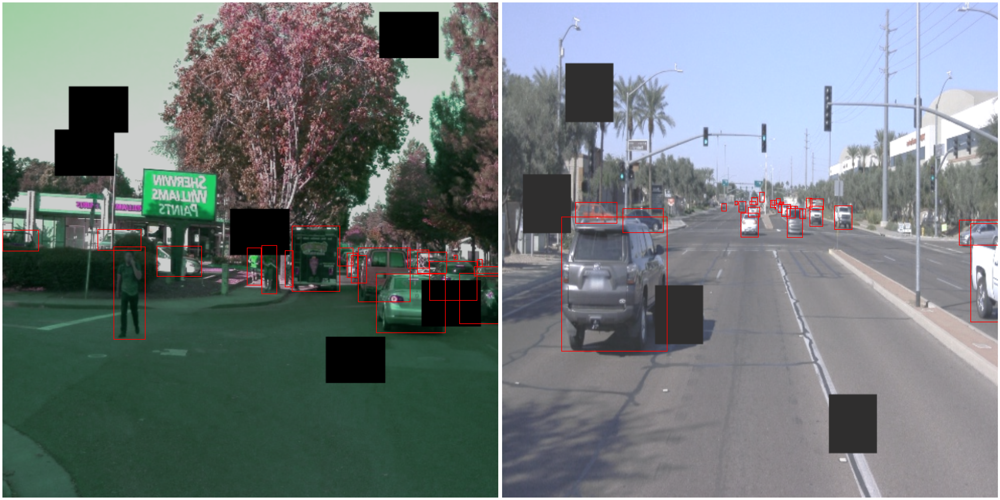

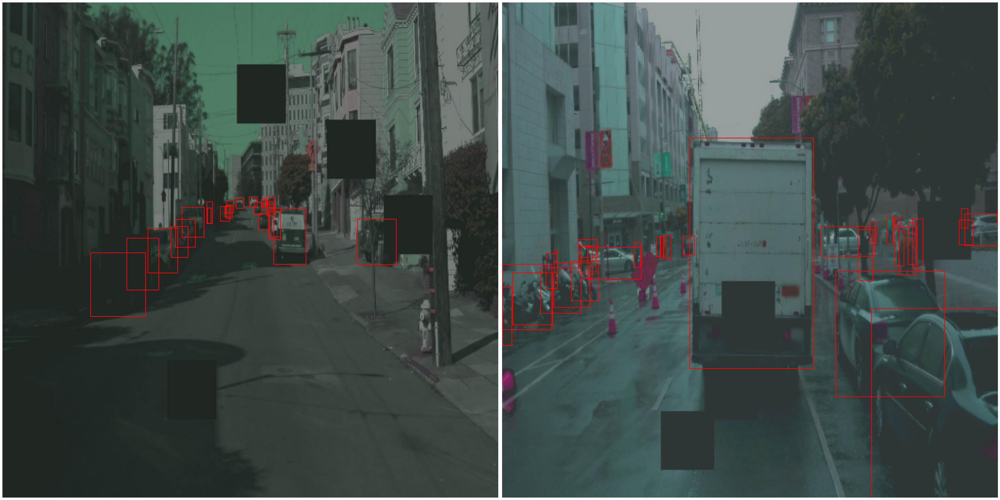

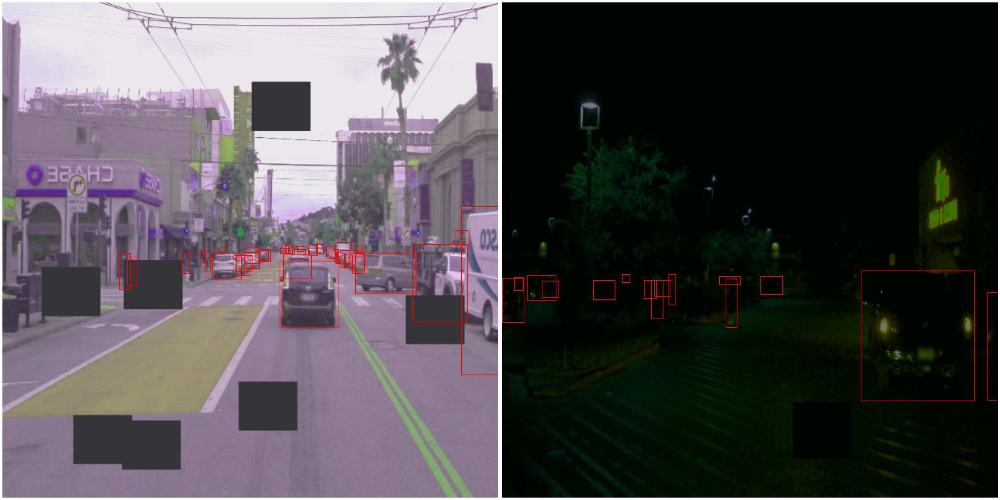

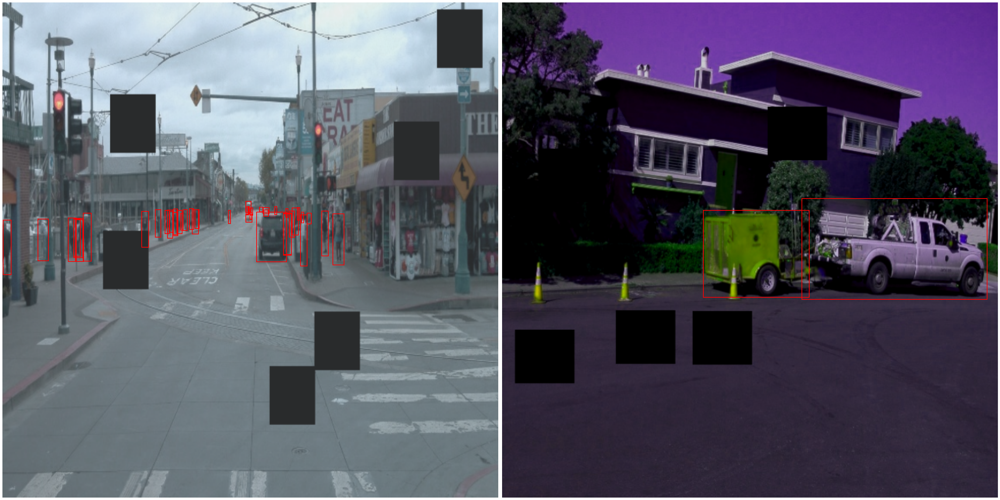

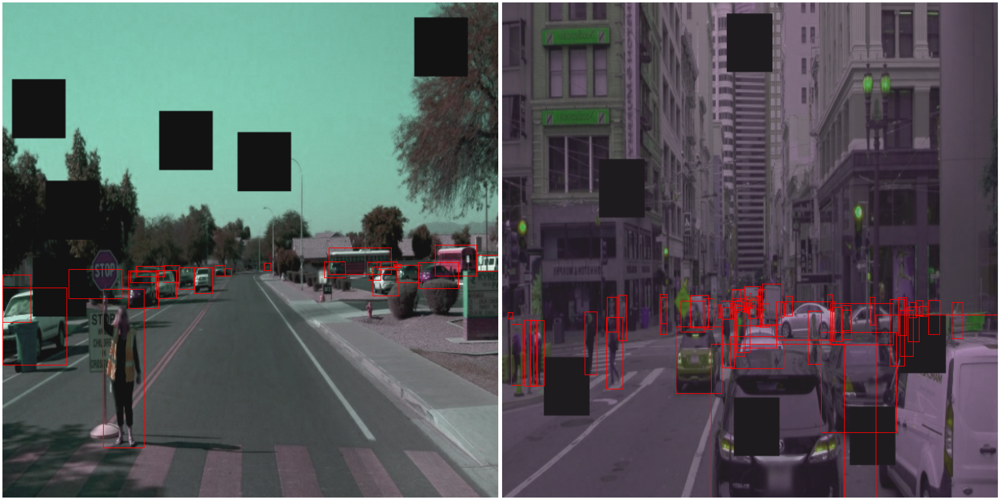

In [28]:
%matplotlib inline

for batch in train_dataset.take(5):
    display_batch(batch)

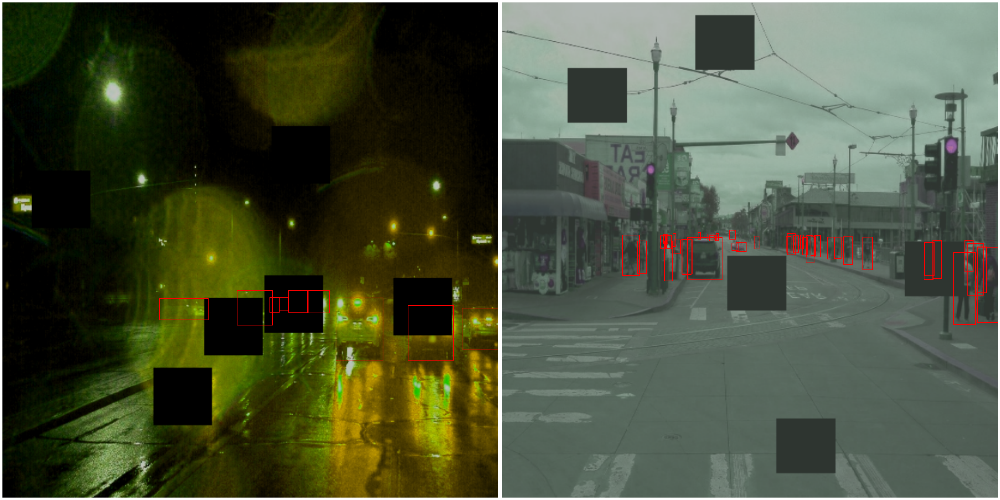

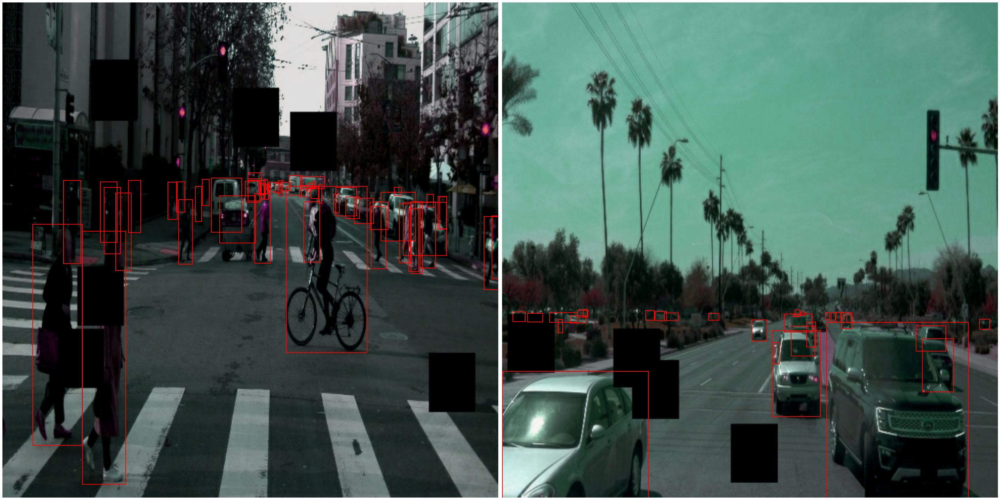

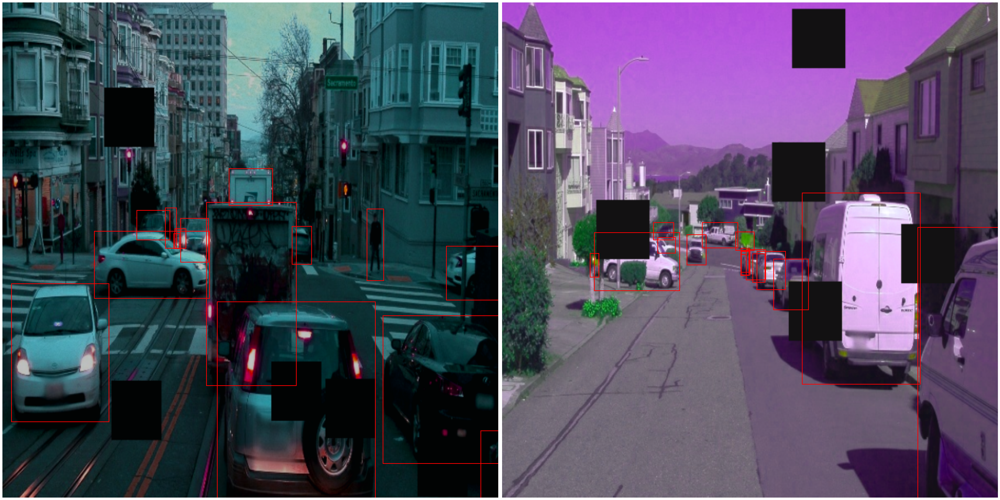

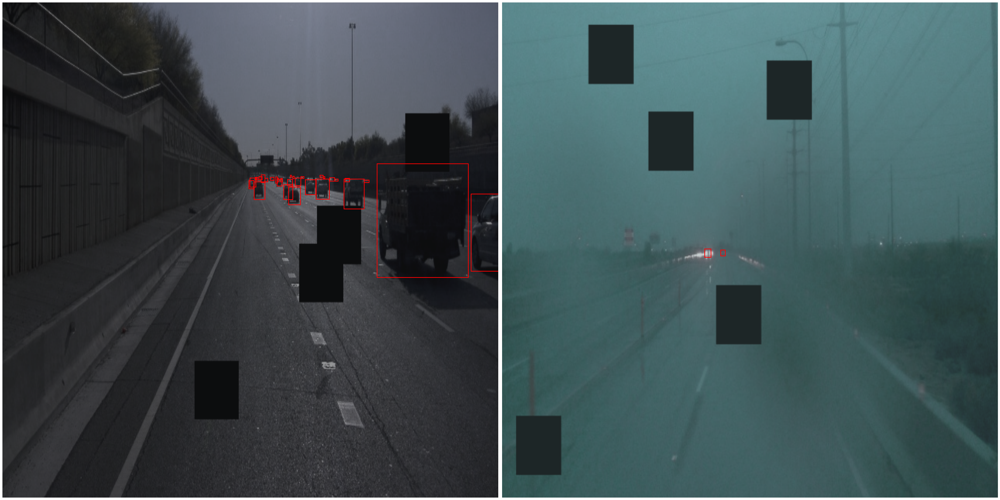

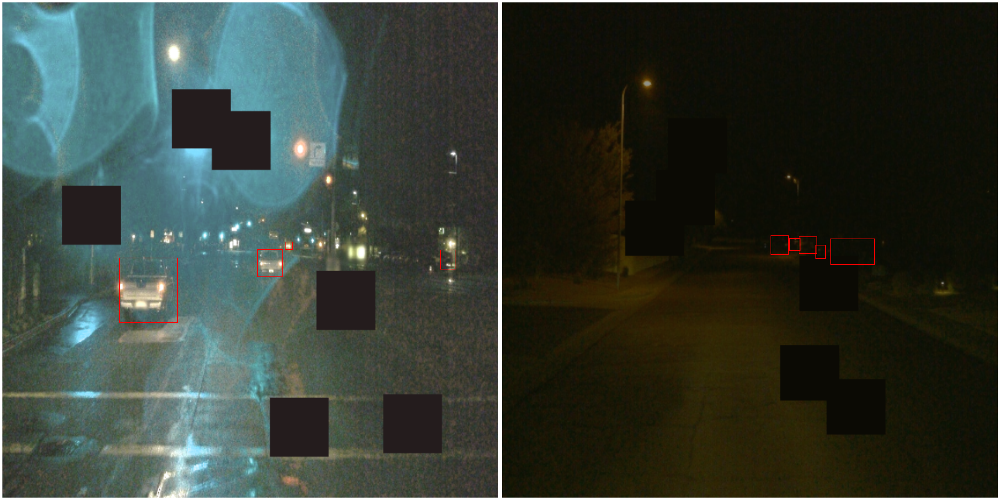

In [31]:
%matplotlib inline

for batch in train_dataset.take(5):
    display_batch(batch)